# Processing Sequences Using RNNs and CNNs

In [1]:
import sys

assert sys.version_info >= (3, 7)

In [2]:
import matplotlib.pyplot as plt

plt.rc('font', size=14)
plt.rc('axes', labelsize=14, titlesize=14)
plt.rc('legend', fontsize=14)
plt.rc('xtick', labelsize=10)
plt.rc('ytick', labelsize=10)

In [3]:
from pathlib import Path

IMAGES_PATH = Path() / "images" / "rnn"
IMAGES_PATH.mkdir(parents=True, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = IMAGES_PATH / f"{fig_id}.{fig_extension}"
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

In [4]:
import tensorflow as tf
devices = tf.config.list_physical_devices()
print("\nDevices: ", devices)

gpus = tf.config.list_physical_devices('GPU')
if gpus:
  details = tf.config.experimental.get_device_details(gpus[0])
  print("GPU details: ", details)


Devices:  [PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'), PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
GPU details:  {'device_name': 'METAL'}


In [5]:
import tensorflow as tf
if not tf.config.list_physical_devices('GPU'):
    print("No GPU was detected. Neural nets can be very slow without a GPU.")
    if "google.colab" in sys.modules:
        print("Go to Runtime > Change runtime and select a GPU hardware "
              "accelerator.")
    if "kaggle_secrets" in sys.modules:
        print("Go to Settings > Accelerator and select GPU.")

## RNN / Recurrent Neural Networks

Class of nets that can predict the future (up to a point). Specializes in analyzing sequences of arbitrary lengths, rather than on fixed-sized inputs. They can take time series data, sentences, documents, or audio samples as input.

2 Main Difficulties that RNNs face:
1. Unstable gradients, whcih can be alleviated using various techniques such as *recurrent dropout* and *recurrent layer normalization*.
2. Very limited short-term memory, which can be extended using LSTM and GRU cells.

## Recurrent Neurons and Layers

Recurrent NN looks very much like feedforward NN, except it also has connections pointing backwards.

Basically, it not only accepts input from data, but also from itself from the previous step!

Each recurrent neuron has 2 sets of weights, 
1. one for the inputs X(t): Wx
2. the other for outputs of the previous time step y(t-1): Wy

### Memory Cells

Since the output of a recurrent neuron at time step t is a function of all the inputs from previous time steps, we can say it has a form of *memory*. A part of a neural network that preserves some state across time steps is called a *memory cell*.

### Input and Output Sequences

*sequence-to-sequence* : simultaneously take a sequence of inputs and produce a sequence of outputs

*sequence-to-vector* (encoder) : take a sequence of inputs and ignore all outputs except for the last one

*vector-to-sequence* (decoder) : feed the same input vector over and over again at each time step and let it output a sequence

encodr + decoder = used for translating languages. Takes a sentence in one language and convert it to a single vector representation. Then decode the vector into a sentence in another language.

## Training RNNs

To train an RNN, we need to unroll it through time and use regular backpropagation (aka *backpropagation through time* [BPTT]).

We first forward pass through the unrolled network and then the output sequence is evaluated using a loss function (the loss function may ignore some outputs), afterwars the gradients of the loss function are then propagated backward through the unrolled network.

Watch video on backpropagation in RNN to ensure that I understand what is happening!

## Forecasting a Time Series

In [8]:
filepath = tf.keras.utils.get_file(
    "ridership.tgz",
    "https://github.com/ageron/data/raw/main/ridership.tgz",
    cache_dir=".",
    extract=True
)
if "_extracted" in filepath:
    ridership_path = Path(filepath) / "ridership"
else:
    ridership_path = Path(filepath).with_name("ridership")

In [9]:
import pandas as pd
from pathlib import Path

path = Path("datasets/ridership/CTA_-_Ridership_-_Daily_Boarding_Totals.csv")
df = pd.read_csv(path, parse_dates=["service_date"])
df.columns = ["date", "day_type", "bus", "rail", "total"]  # shorter names
df = df.sort_values("date").set_index("date")
df = df.drop("total", axis=1)  # no need for total, it's just bus + rail
df = df.drop_duplicates()  # remove duplicated months (2011-10 and 2014-07)

In [10]:
df.head()

,day_type,bus,rail
date,,,
2001-01-01,U,297192,126455
2001-01-02,W,780827,501952
2001-01-03,W,824923,536432
2001-01-04,W,870021,550011
2001-01-05,W,890426,557917


<function matplotlib.pyplot.show(close=None, block=None)>

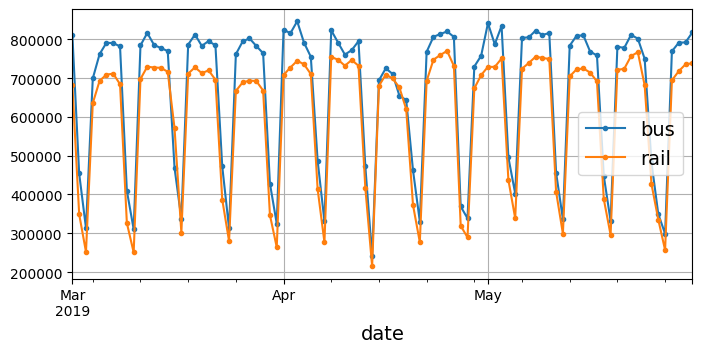

In [12]:
import matplotlib.pyplot as plt

df["2019-03":"2019-05"].plot(grid=True, marker=".", figsize=(8,3.5))
plt.show

The above is called a *multivariate time series* since it has multiple values per time step.

We can see that there is a similar patter clearly repeated every week (*seasonality*). *Naive Forecasting* (copying past values as future prediction) is often a great baseline, and it can even be tricky to beat in some cases.

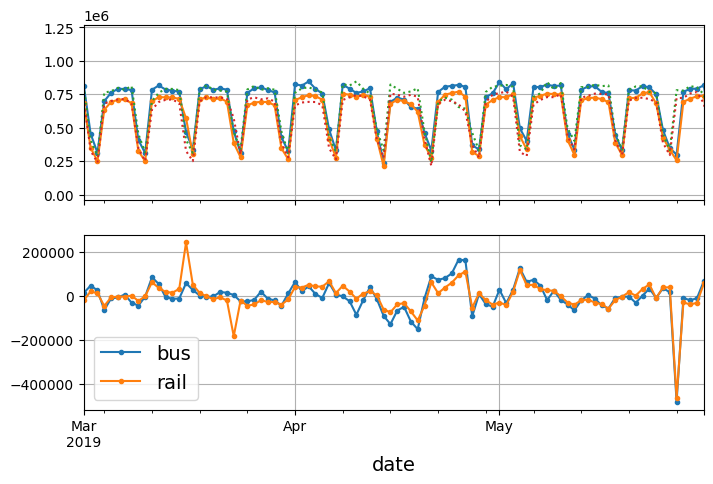

In [15]:
diff_7 = df[["bus", "rail"]].diff(7)["2019-03":"2019-05"]

fig, axs = plt.subplots(2, 1, sharex=True, figsize=(8,5))
df.plot(ax=axs[0], legend=False, marker=".")
df.shift(7).plot(ax=axs[0], grid=True, legend=False, linestyle=":")
diff_7.plot(ax=axs[1], grid=True, marker=".")
plt.show()

WHen a time series is correlated with a lagged version of itself, we say that the time series is *autocorrelated*. 

In [ ]:
# long weekend during the last few days of May!
list(df.loc["2019-05-25":"2019-05-27"]["day_type"])

['A', 'U', 'U']

In [18]:
diff_7.abs().mean()

bus     43915.608696
rail    42143.271739
dtype: float64

In [ ]:
# MAPE / Mean Absolute Percentage Error
targets = df[["bus", "rail"]]["2019-03":"2019-05"]
(diff_7 / targets).abs().mean()

bus     0.082938
rail    0.089948
dtype: float64

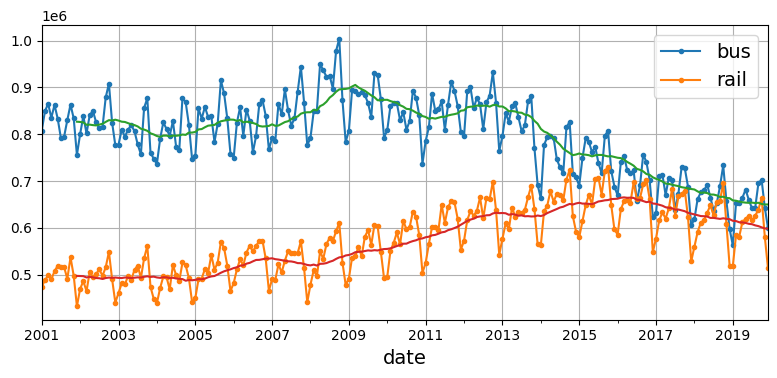

In [21]:
period = slice("2001", "2019")
try:
    df_monthly = df.select_dtypes(include="number").resample('ME').mean()  # compute the mean for each month
    rolling_average_12_months = df_monthly.loc[period].rolling(window=12).mean()
except ValueError as ex:
    try:
        df_monthly = df.select_dtypes(include="number").resample('M').mean()  # compute the mean for each month
        rolling_average_12_months = df_monthly.loc[period].rolling(window=12).mean()
    except ValueError as ex:
        df_monthly = df.resample('M').mean()  # compute the mean for each month
        rolling_average_12_months = df_monthly[period].rolling(window=12).mean()

fig, ax = plt.subplots(figsize=(8, 4))
df_monthly[period].plot(ax=ax, marker=".")
rolling_average_12_months.plot(ax=ax, grid=True, legend=False)
save_fig("long_term_ridership_plot")  # extra code – saves the figure for the book
plt.show()

We also observe some yearly seasonality, though it is noisier than the weekly seasonality, and more visible for rail series than the bus series.

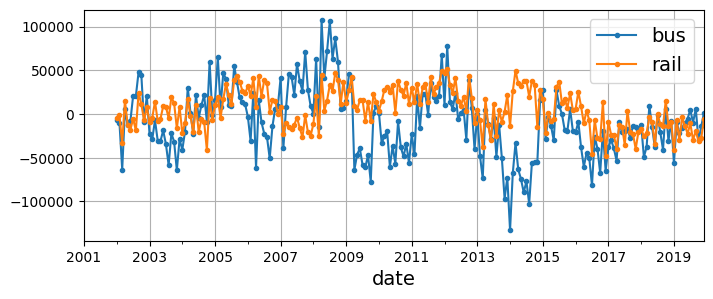

In [23]:
df_monthly.diff(12)[period].plot(grid=True, marker=".", figsize=(8,3))
plt.show()

Notice that the differencing has removed both the yearly and long-term trends. In fact differencing is a common technique to remove trends and seasonality from a time series as it is easier to study *stationary* time series (where a statistical property remain constant over time).

### The ARMA Model Family

In general, this model family assumes that the time series is stationary. 

*AutoRegressive Moving Average* computes its forecast using a simple weighted sum of lagged values and corrects these forecasts by adding a moving average.

    Has the hyperparameter p (# of past values to be used for computing the weighted sum) and q (# of past forecast errors)

In general, running *d* consecutive rounds of differencing computes an approximation of the *$d^{th}$* order derivative of the time series, so it will eliminate polynomial trends up to degree *d* (*order of integration*)
ARMA + differencing = *ARIMA* / *AutoRegressive Integrated Moving Average*

SARIMA / *seasonal* ARIMA models the time series in the same way as ARIMA, but additionally models a seasonal component for a given frequency, using the same ARIMA approach. In total it has 7 hyperparameters, (p, d, and q and P, D, Q (to model the seasonal pattern), and s (period of the seasonal pattern)).

In [25]:
from statsmodels.tsa.arima.model import ARIMA

origin, today = "2019-01-01", "2019-05-31"
# D = daily time series frequency
rail_series = df.loc[origin:today]["rail"].asfreq("D")
model = ARIMA(rail_series,
              order = (1,0,0), # p,d,q
              seasonal_order = (0,1,1,7)) # P, D, Q, s
model = model.fit()
y_pred = model.forecast()
y_pred

/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/numpy/linalg/_linalg.py:3437: RuntimeWarning: divide by zero encountered in matmul
  return _core_matmul(x1, x2)
/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/numpy/linalg/_linalg.py:3437: RuntimeWarning: overflow encountered in matmul
  return _core_matmul(x1, x2)
/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/numpy/linalg/_linalg.py:3437: RuntimeWarning: invalid value encountered in matmul
  return _core_matmul(x1, x2)


2019-06-01    427758.626364
Freq: D, dtype: float64

In [26]:
df["rail"].loc["2019-06-01"]  # target value

np.int64(379044)

In [27]:
df["rail"].loc["2019-05-25"]  # naive forecast (value from one week earlier)

np.int64(426932)

Loop to make forecast for every day in March, April and May, and compute the MAE over that period.

In [28]:
origin, start_date, end_date = "2019-01-01", "2019-03-01", "2019-05-31"
time_period = pd.date_range(start_date, end_date)
rail_series = df.loc[origin:end_date]["rail"].asfreq("D")
y_preds = []
for today in time_period.shift(-1):
    model = ARIMA(rail_series[origin:today],  # train on data up to "today"
                  order=(1, 0, 0),
                  seasonal_order=(0, 1, 1, 7))
    model = model.fit()  # note that we retrain the model every day!
    y_pred = model.forecast().iloc[0]
    y_preds.append(y_pred)

y_preds = pd.Series(y_preds, index=time_period)
mae = (y_preds - rail_series[time_period]).abs().mean()  # returns 32,040.7
mae

/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/numpy/linalg/_linalg.py:3437: RuntimeWarning: divide by zero encountered in matmul
  return _core_matmul(x1, x2)
/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/numpy/linalg/_linalg.py:3437: RuntimeWarning: overflow encountered in matmul
  return _core_matmul(x1, x2)
/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/numpy/linalg/_linalg.py:3437: RuntimeWarning: invalid value encountered in matmul
  return _core_matmul(x1, x2)
/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/numpy/linalg/_linalg.py:3437: RuntimeWarning: divide by zero encountered in matmul
  return _core_matmul(x1, x2)
/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/numpy/linalg/_linalg.py:3437: RuntimeWarning: overflow encountered in matmul
  return _core_matmul(x1, x2)
/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/numpy/linalg/_linalg.py:3437: RuntimeWarning: invalid value encountere

np.float64(32040.72010625286)

/var/folders/7j/0rhz18qs4d9dzfjkz9p2xlcr0000gn/T/ipykernel_26333/2292568549.py:4: UserWarning: This axis already has a converter set and is updating to a potentially incompatible converter
  ax.plot(y_preds, color="r", marker=".", label="SARIMA Forecasts")


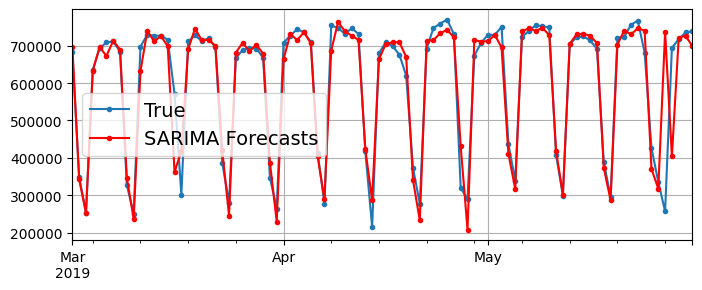

In [29]:
# extra code – displays the SARIMA forecasts
fig, ax = plt.subplots(figsize=(8, 3))
rail_series.loc[time_period].plot(label="True", ax=ax, marker=".", grid=True)
ax.plot(y_preds, color="r", marker=".", label="SARIMA Forecasts")
plt.legend()
plt.show()

Choosing a good hyperparameter can be done via grid search. Good p, q, P and Q values are usually fairly small (0-2, sometimes up to 5-6), and d and D are typically 0 or 1, sometimes 2. For s, it's just the mian seasonal pattern period (7 in this case).

Other more principled approaches to selecting good hyperparameters based on analyzing the *autocorrelation function* (ACF) and *partial autocorrelation function* (PACF), or minimizing the AIC or BIC metrics.

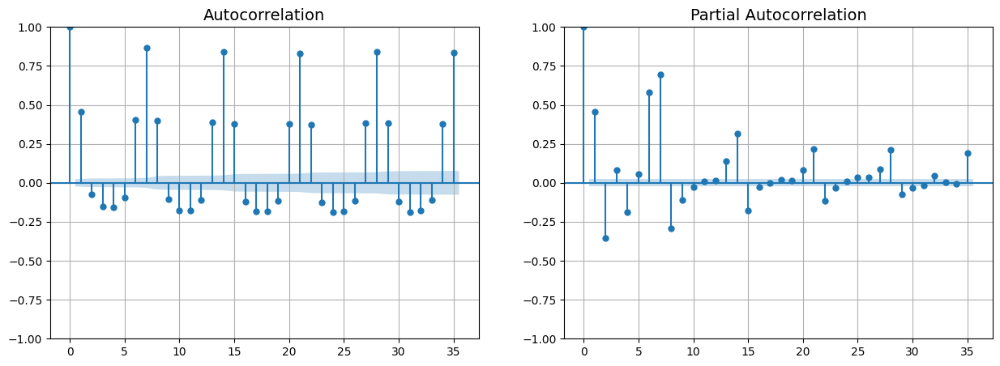

In [30]:
# extra code – shows how to plot the Autocorrelation Function (ACF) and the
#              Partial Autocorrelation Function (PACF)

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))
plot_acf(df[period]["rail"], ax=axs[0], lags=35)
axs[0].grid()
plot_pacf(df[period]["rail"], ax=axs[1], lags=35, method="ywm")
axs[1].grid()
plt.show()

### Preparing the Data for Machine Learning Models

In [31]:
import tensorflow as tf

my_series = [0,1,2,3,4,5]
my_dataset = tf.keras.utils.timeseries_dataset_from_array(
    my_series,
    targets=my_series[3:],
    sequence_length = 3,
    batch_size=2
)

2025-06-12 15:42:09.464470: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M4
2025-06-12 15:42:09.464669: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 24.00 GB
2025-06-12 15:42:09.464700: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 8.00 GB
I0000 00:00:1749714129.465369 5647046 pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
I0000 00:00:1749714129.465444 5647046 pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [33]:
list(my_dataset)

2025-06-12 15:42:17.926576: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


[(<tf.Tensor: shape=(2, 3), dtype=int32, numpy=
  array([[0, 1, 2],
         [1, 2, 3]], dtype=int32)>,
  <tf.Tensor: shape=(2,), dtype=int32, numpy=array([3, 4], dtype=int32)>),
 (<tf.Tensor: shape=(1, 3), dtype=int32, numpy=array([[2, 3, 4]], dtype=int32)>,
  <tf.Tensor: shape=(1,), dtype=int32, numpy=array([5], dtype=int32)>)]

In [36]:
for window_dataset in tf.data.Dataset.range(6).window(4, shift=1, drop_remainder=True):
    for element in window_dataset:
        print(f"{element}", end=" ")
    print()

0 1 2 3 
1 2 3 4 
2 3 4 5 


In [37]:
dataset = tf.data.Dataset.range(6).window(4, shift=1, drop_remainder=True)
dataset = dataset.flat_map(lambda window_dataset: window_dataset.batch(4))
for window_tensor in dataset:
    print(f"{window_tensor}")

[0 1 2 3]
[1 2 3 4]
[2 3 4 5]


In [38]:
def to_windows(dataset, length):
    dataset = dataset.window(length, shift=1, drop_remainder=True)
    return dataset.flat_map(lambda window_ds: window_ds.batch(length))

In [39]:
dataset = to_windows(tf.data.Dataset.range(6), 4)
dataset = dataset.map(lambda window: (window[:-1], window[-1]))
list(dataset.batch(2))

[(<tf.Tensor: shape=(2, 3), dtype=int64, numpy=
  array([[0, 1, 2],
         [1, 2, 3]])>,
  <tf.Tensor: shape=(2,), dtype=int64, numpy=array([3, 4])>),
 (<tf.Tensor: shape=(1, 3), dtype=int64, numpy=array([[2, 3, 4]])>,
  <tf.Tensor: shape=(1,), dtype=int64, numpy=array([5])>)]

In [40]:
rail_train = df["rail"]["2016-01":"2018-12"] / 1e6
rail_valid = df["rail"]["2019-01":"2019-05"] / 1e6
rail_test = df["rail"]["2019-06":] / 1e6


In [41]:
seq_length = 56
train_ds = tf.keras.utils.timeseries_dataset_from_array(
    rail_train.to_numpy(),
    targets=rail_train[seq_length:],
    sequence_length = seq_length,
    batch_size=32,
    shuffle=True,
    seed=42
)
valid_ds = tf.keras.utils.timeseries_dataset_from_array(
    rail_valid.to_numpy(),
    targets = rail_valid[seq_length:],
    sequence_length = seq_length,
    batch_size = 32
)

### Forecasting Using a Linear Model

In [42]:
tf.random.set_seed(42)
model = tf.keras.Sequential([
    tf.keras.layers.Dense(1, input_shape=[seq_length])
])
early_stopping_cb = tf.keras.callbacks.EarlyStopping(
    monitor="val_mae",
    patience=50,
    restore_best_weights=True
)
opt = tf.keras.optimizers.SGD(learning_rate=0.02, momentum=0.9)
model.compile(loss=tf.keras.losses.Huber(), optimizer=opt,metrics=["mae"])
history = model.fit(train_ds, validation_data = valid_ds, epochs=500,
                    callbacks=[early_stopping_cb])

/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/500


2025-06-12 15:56:57.688050: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 28ms/step - loss: 0.6595 - mae: 1.0816 - val_loss: 0.0832 - val_mae: 0.3790
Epoch 2/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0428 - mae: 0.2448 - val_loss: 0.0106 - val_mae: 0.1166
Epoch 3/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0093 - mae: 0.1047 - val_loss: 0.0081 - val_mae: 0.0932
Epoch 4/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0082 - mae: 0.0945 - val_loss: 0.0076 - val_mae: 0.0896
Epoch 5/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0071 - mae: 0.0849 - val_loss: 0.0063 - val_mae: 0.0781
Epoch 6/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0067 - mae: 0.0817 - val_loss: 0.0060 - val_mae: 0.0759
Epoch 7/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0065 - mae: 0.0815 - val_loss: 0.0060 - val_mae: 0.0784
Epoch 8/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0061 - mae: 0.0799 - val_loss: 0.0058 - val_mae: 0.0770
Epoch 9/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0064 - mae: 0.

In [43]:
# extra code – evaluates the model
valid_loss, valid_mae = model.evaluate(valid_ds)
valid_mae * 1e6

3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 0.0018 - mae: 0.0388


37592.10556745529

### Forecasting Using a Simple RNN

In [44]:
model = tf.keras.Sequential([
    # input_shape = [any length, 1 dimension]
    tf.keras.layers.SimpleRNN(1, input_shape=[None,1])
])

/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [45]:
# extra code – defines a utility function we'll reuse several time

def fit_and_evaluate(model, train_set, valid_set, learning_rate, epochs=500):
    early_stopping_cb = tf.keras.callbacks.EarlyStopping(
        monitor="val_mae", patience=50, restore_best_weights=True)
    opt = tf.keras.optimizers.SGD(learning_rate=learning_rate, momentum=0.9)
    model.compile(loss=tf.keras.losses.Huber(), optimizer=opt, metrics=["mae"])
    history = model.fit(train_set, validation_data=valid_set, epochs=epochs,
                        callbacks=[early_stopping_cb])
    valid_loss, valid_mae = model.evaluate(valid_set)
    return valid_mae * 1e6

In [46]:
fit_and_evaluate(model, train_ds, valid_ds, learning_rate=0.02)

Epoch 1/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 32s 917ms/step - loss: 0.0404 - mae: 0.2252 - val_loss: 0.0204 - val_mae: 0.1646
Epoch 2/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 29s 881ms/step - loss: 0.0186 - mae: 0.1576 - val_loss: 0.0196 - val_mae: 0.1506
Epoch 3/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 29s 884ms/step - loss: 0.0183 - mae: 0.1569 - val_loss: 0.0190 - val_mae: 0.1487
Epoch 4/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 29s 881ms/step - loss: 0.0176 - mae: 0.1545 - val_loss: 0.0184 - val_mae: 0.1483
Epoch 5/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 29s 876ms/step - loss: 0.0177 - mae: 0.1584 - val_loss: 0.0179 - val_mae: 0.1495
Epoch 6/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 29s 881ms/step - loss: 0.0176 - mae: 0.1596 - val_loss: 0.0177 - val_mae: 0.1457
Epoch 7/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 30s 905ms/step - loss: 0.0162 - mae: 0.1512 - val_loss: 0.0177 - val_mae: 0.1419
Epoch 8/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 31s 933ms/step - loss: 0.0165 - mae: 0.1472 - val_loss: 0.0170 - val_mae: 0.1498
Epoch 9/500
33/33 ━━━━━━━━━━━━━━━━━━━━ 2

102795.0868010521

In [47]:
univar_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, input_shape=[None,1]),
    tf.keras.layers.Dense(1) # no activation function by default
])

/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [ ]:
# extra code – compiles, fits, and evaluates the model, like earlier
fit_and_evaluate(univar_model, train_ds, valid_ds, learning_rate=0.05)

While the model can perform quite well even WITHOUT preproessing, to get the best performance, we still want to try and make the time series more stationary (by using differencing)

### Forecasting Using a Deep RNN

In [48]:
deep_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, return_sequences=True, input_shape=[None,1]),
    tf.keras.layers.SimpleRNN(32, return_sequences=True),
    tf.keras.layers.SimpleRNN(32), #sequence to vector
    tf.keras.layers.Dense(1)
])

In [ ]:
# extra code – compiles, fits, and evaluates the model, like earlier
fit_and_evaluate(deep_model, train_ds, valid_ds, learning_rate=0.01)

### Forecasting Multivariate Time Series

In [53]:
df_mulvar = df[["bus", "rail"]] / 1e6  # use both bus & rail series as input
df_mulvar["next_day_type"] = df["day_type"].shift(-1)  # we know tomorrow's type
df_mulvar = pd.get_dummies(df_mulvar, dtype=float)  # one-hot encode the day type

In [54]:
mulvar_train = df_mulvar["2016-01":"2018-12"]
mulvar_valid = df_mulvar["2019-01":"2019-05"]
mulvar_test = df_mulvar["2019-06":]

In [55]:
tf.random.set_seed(42)  # extra code – ensures reproducibility

train_mulvar_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_train.to_numpy(),  # use all 5 columns as input
    targets=mulvar_train["rail"][seq_length:],  # forecast only the rail series
    sequence_length=seq_length,
    batch_size=32,
    shuffle=True,
    seed=42
)
valid_mulvar_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_valid.to_numpy(),
    targets=mulvar_valid["rail"][seq_length:],
    sequence_length=seq_length,
    batch_size=32
)

In [ ]:
tf.random.set_seed(42)  # extra code – ensures reproducibility
mulvar_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, input_shape=[None, 5]),
    tf.keras.layers.Dense(1)
])

In [ ]:
# extra code – compiles, fits, and evaluates the model, like earlier
fit_and_evaluate(mulvar_model, train_mulvar_ds, valid_mulvar_ds,
                 learning_rate=0.05)

Using a single model for multiple related tasks often results in better performance than using a separate model for each task, since features learned for one task my be useful for the other tasks, and also because having to perform well across multiple tasks prevents the model from overfitting (form of regularization). 

In [ ]:
# extra code – build and train a multitask RNN that forecasts both bus and rail

tf.random.set_seed(42)

seq_length = 56
train_multask_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_train.to_numpy(),
    targets=mulvar_train[["bus", "rail"]][seq_length:],  # 2 targets per day
    sequence_length=seq_length,
    batch_size=32,
    shuffle=True,
    seed=42
)
valid_multask_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_valid.to_numpy(),
    targets=mulvar_valid[["bus", "rail"]][seq_length:],
    sequence_length=seq_length,
    batch_size=32
)

tf.random.set_seed(42)
multask_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, input_shape=[None, 5]),
    tf.keras.layers.Dense(2)
])

fit_and_evaluate(multask_model, train_multask_ds, valid_multask_ds,
                 learning_rate=0.02)

### Forecasting Several Time Steps Ahead

In [ ]:
import numpy as np
X = rail_valid.to_numpy()[np.newaxis, :seq_length, np.newaxis]
for step_ahead in range(14):
    y_pred_one = univar_model.predict(X)
    X = np.concatenate([X, y_pred_one.reshape(1,1,1)], axis=1)

In the code above, we take the rail ridership of the first 56 days of the validation period, and convert the data to a np array of shape [1, 56, 1]. Then we repeatedly use the model to forecast the next value, and append each forecast to the input series, along the time axis `(axis = 1)`.

In [ ]:
# extra code – generates and saves Figure 15–11

# The forecasts start on 2019-02-26, as it is the 57th day of 2019, and they end
# on 2019-03-11. That's 14 days in total.
Y_pred = pd.Series(X[0, -14:, 0],
                   index=pd.date_range("2019-02-26", "2019-03-11"))

fig, ax = plt.subplots(figsize=(8, 3.5))
(rail_valid * 1e6)["2019-02-01":"2019-03-11"].plot(
    label="True", marker=".", ax=ax)
(Y_pred * 1e6).plot(
    label="Predictions", grid=True, marker="x", color="r", ax=ax)
ax.vlines("2019-02-25", 0, 1e6, color="k", linestyle="--", label="Today")
ax.set_ylim([200_000, 800_000])
plt.legend(loc="center left")
save_fig("forecast_ahead_plot")
plt.show()

We can also create an RNN to predict the next 14 values in one shot! We can still use the sequence-to-vector model, but it will output 14 values instead of 1.

In [ ]:
def split_inputs_and_targets(mulvar_series, ahead=14, target_col=1):
    return mulvar_series[:, :-ahead], mulvar_series[:,-ahead:, target_col]

ahead_train_ds = tf.keras.utils.timeseries_dataset_from_array(
    mulvar_train.to_numpy(),
    targets=None,
    sequence_length = seq_length+14,
    batch_size=32,
    shuffle=True,
    seed=42
).map(split_inputs_and_targets)

ahead_valid_ds = tf.keras.utils.timeseires_dataset_from_array(
    mulvar_valid.to_numpy(),
    targets = None,
    sequence = seq_length + 14
    batch_size=32
).map(split_inputs_and_targets)


In [ ]:
ahead_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, input_shape=[None, 5]),
    tf.keras.layers.Dense(14)
])

In [ ]:
# extra code – compiles, fits, and evaluates the model, like earlier
fit_and_evaluate(ahead_model, ahead_train_ds, ahead_valid_ds,
                 learning_rate=0.02)

In [ ]:
X = mulvar_valid.to_numpy()[np.newaxis, :seq_length]  # shape [1, 56, 5]
Y_pred = ahead_model.predict(X)  # shape [1, 14]

### Forecasting Using a Sequence-to-Sequence Model

Instead of training the model to forecast the next 14 values only at the very last time step, we can train to forecast the next 14 values at each and every time step!

The advantage is that it will contain a term for the output of the RNN at each and every time step, not just for the output at the last time step!

This implies many more error gradients flowing through the model, and they won't have to flow through time as much since they will come from the output of each time step.

To prepare the dataset, we can use the `to_windows()` utility function we created earlier

In [ ]:
my_series = tf.data.Dataset.range(7)
dataset = to_windows(to_windows(my_series, 3), 4)
list(dataset)

In [ ]:
# split to input and targets
dataset = dataset.map(lambda S: (S[:, 0], S[:, 1:]))
list(dataset)

In [ ]:
def to_seq2seq_dataset(series, seq_length=56, ahead=14, target_col=1,
                       batch_size=32, shuffle=False, seed=None):
    ds = to_windows(tf.data.Dataset.from_tensor_slices(series), ahead+1)
    ds = to_windows(ds, seq_length).map(lambda S: (S[:, 0], S[:, 1:, 1]))
    if shuffle:
        ds = ds.shuffle(8 * batch_size, seed=seed)
    return ds.batch(batch_size)

In [ ]:
seq2seq_train = to_seq2seq_dataset(mulvar_train, shuffle=True, seed=42)
seq2seq_valid = to_seq2seq_dataset(mulvar_valid)

In [ ]:
seq2seq_model = tf.keras.Sequential([
    tf.keras.layers.SimpleRNN(32, return_sequences=True, input_shape=[None, 5]),
    tf.keras.layers.Dense(14)
])

In [ ]:
fit_and_evaluate(seq2seq_model, seq2seq_train, seq2seq_valid,
                 learning_rate=0.1)

In [ ]:
X = mulvar_valid.to_numpy()[np.newaxis, :seq_length]
y_pred_14 = seq2seq_model.predict(X)[0, -1]  # only the last time step's output

In [ ]:
Y_pred_valid = seq2seq_model.predict(seq2seq_valid)
for ahead in range(14):
    preds = pd.Series(Y_pred_valid[:-1, -1, ahead],
                      index=mulvar_valid.index[56 + ahead : -14 + ahead])
    mae = (preds - mulvar_valid["rail"]).abs().mean() * 1e6
    print(f"MAE for +{ahead + 1}: {mae:,.0f}")

## Handling Long Sequences

### Fighting the Unstable Gradients Problem

Nonsaturating activation functions (function's gradient doesn't approach zero when the input values become very large or small) may not help much in RNNs and make it even more unstable because as the gradient descent updates the weights, since the same weights are used at every time step, the outputs at the subsequent steps may be increased / decreased consecutively!

Hence, we can reduce this risk by using a smaller laerning rate or use a saturating activation function (like the hyperbolic tangent -> default).

If the gradiients are exploding, monitor the size of the gradients (using Tensorboard) and perhaps use gradient clipping.

BNs can be used, but is only slightly beneficial when it was applied to the layer's inputs, not to the hidden states. Hence, try using *layer normalization* where instead of normalizing across the batch dimension, it normalizes across the features dimension.

To implement layer normalization, we need to define a custom memory cell, which is just like a regular layer, except its `call()` method takes 2 arguments
1. `inputs` at the current time step;
2. hidden `states` from the previous time step (list containing one or more tensors) **read and research more about what this is**

In [ ]:
class LNSimpleRNNCell(tf.keras.layers.Layer):
    def __init__(self, units, activation="tanh", **kwargs):
        super().__init__(**kwargs)
        self.state_size = units
        self.output_size = units
        self.simple_rnn_cell = tf.keras.layers.SimpleRNNCell(units, activation=None)
        self.layer_norm = tf.keras.layers.LayerNormalization()
        self.activation = tf.keras.activations.get(activation)
    
    def call(self, inputs, states):
        # apply the simpleRNNCell (computes a linear combination
        # of the current inputs and the previous hidden states and returns the result twice)
        outputs, new_states = self.simple_rnn_cell(inputs, states)
        # applies layer normalization, followed by the activation function
        norm_outputs = self.activation(self.layer_norm(outputs))
        # return the outputs twice; once as the outputs, once as the new hidden states
        return norm_outputs, [norm_outputs]

In [ ]:
custom_ln_model = tf.keras.Sequential([
    tf.keras.layers.RNN(LNSimpleRNNCell(32), return_sequences=True,
                        input_shape=[None, 5]),
                        tf.keras.layers.Dense(14)
])

In [ ]:
fit_and_evaluate(custom_ln_model, seq2seq_train, seq2seq_valid,
                 learning_rate=0.1, epochs=5)

#### Extra Material - Creating a Custom RNN Class

In [ ]:
class MyRNN(tf.keras.layers.Layer):
    def __init__(self, cell, return_sequences=False, **kwargs):
        super().__init__(**kwargs)
        self.cell = cell
        self.return_sequences = return_sequences

    def get_initial_state(self, inputs):
        try:
            return self.cell.get_initial_state(inputs)
        except AttributeError:
            # fallback to zeros if self.cell has no get_initial_state() method
            batch_size = tf.shape(inputs)[0]
            return [tf.zeros([batch_size, self.cell.state_size],
                             dtype=inputs.dtype)]

    @tf.function
    def call(self, inputs):
        states = self.get_initial_state(inputs)
        shape = tf.shape(inputs)
        batch_size = shape[0]
        n_steps = shape[1]
        sequences = tf.TensorArray(
            inputs.dtype, size=(n_steps if self.return_sequences else 0))
        outputs = tf.zeros(shape=[batch_size, self.cell.output_size],
                           dtype=inputs.dtype)
        for step in tf.range(n_steps):
            outputs, states = self.cell(inputs[:, step], states)
            if self.return_sequences:
                sequences = sequences.write(step, outputs)

        if self.return_sequences:
            # stack the outputs into an array of shape
            # [time steps, batch size, dims], then transpose it to shape
            # [batch size, time steps, dims]
            return tf.transpose(sequences.stack(), [1, 0, 2])
        else:
            return outputs

Note that `@tf.function` requires the `outputs` variable to be created before the `for` loop, which is why we initialize its value to a zero tensor, even though we don't use that value at all. Once the function is converted to a graph, this unused value will be pruned from the graph, so it doesn't impact performance. Similarly, `@tf.function` requires the `sequences` variable to be created before the `if` statement where it is used, even if `self.return_sequences` is `False`, so we create a `TensorArray` of size 0 in this case.

In [ ]:
tf.random.set_seed(42)

custom_model = tf.keras.Sequential([
    MyRNN(LNSimpleRNNCell(32), return_sequences=True, input_shape=[None, 5]),
    tf.keras.layers.Dense(14)
])

In [ ]:
fit_and_evaluate(custom_model, seq2seq_train, seq2seq_valid,
                 learning_rate=0.1, epochs=5)

### Tackling the Short-Term Memory Problem

Since the data goes through transformations when traversing an RNN, some informatio is lost at each time step and after a while the RNN's state contains virutally no trace of the first inputs. To tackle this problem, various types of cells with long-term memory have been introduced.

#### LSTM cells

In short, LSTM can learn to recognize and important input, store it in the long-term state, preserve it for as long as it is needed and extract it whenever it is needed.

LSTM state's is split into 2 vectors
1. $h_{(t)}$ / short-term state
2. $c_{(t)}$ / long-term state

The network can learn what to store in the long-term state, what to throw away, and what to read from it. As the long-term state traverse the netwrok, it gros through a *forget gate*, dropping some memories, and then adds some new memories via the addition operation (adds memories that were selected by an *input gate*).
The result is then sent straight out.

After the addition operation, the long-term state is copied and passed through a tanh function, and then the result is filtered by the *output gate* and produces the short term state.

In terms of where new memories and how the gates work, in the beginning the current input vector $x_{(t)}$ and the previous short-term state $h_{(t-1)}$ are fed to 4 different fully connected layers.
- Main layer is the one that outputs $g_{(t)}$ and has the role of analyzing the current inputs and preivous short-term state. Its most important parts are stored in the long-term state (and the rest is dropped)
- the other 3 layers are *gate controllers* and use the logistic activation function and all fed to element-wise multiplication operations
    - *forget gate* $f_{(t)}$ controls which parts of the long-term state should be erased
    - *input gate* $i_{(t)}$ controls which parts of $g_{(t)}$ should be added to the long-term state
    - *output gate* $o_{(t)}$ controls which parts of the long-term state should be read and output at this time step, both to $h_{(t)}$ and $y_{(t)}$

In [ ]:
model = tf.keras.Sequential([
    tf.keras.layers.LSTM(32, return_sequences=True, input_shape=[None, 5]),
    tf.keras.layers.Dense(14)
])

In [ ]:
fit_and_evaluate(lstm_model, seq2seq_train, seq2seq_valid,
                 learning_rate=0.1, epochs=5)

#### GRU (gated recurrent unit) cells

A simplified version of the LSTM cell and performs just as well. The simplifications are
- both state (short and long-term) vectors are merged into a single vector $h_{(t)}$
- a single gate controller $z_{(t)}$ controls both the forget and input gate
- no output gate; the full state vector is output at every time step, but there is a new gate controller $r_{(t)}$ that controls which part of the previous state will be shown to the main layer ($g_{(t)}$)


In [ ]:
tf.random.set_seed(42)  # extra code – ensures reproducibility
gru_model = tf.keras.Sequential([
    tf.keras.layers.GRU(32, return_sequences=True, input_shape=[None, 5]),
    tf.keras.layers.Dense(14)
])

In [ ]:
fit_and_evaluate(gru_model, seq2seq_train, seq2seq_valid,
                 learning_rate=0.1, epochs=5)

#### Using 1D convolutional layers to process sequences

Similar to a CNN, 1D convolutional layer slides several kernels across a sequence, producing a 1D feature map per kernel. Each kernel will learn to detect a single very short sequential pattern.

```
  |-----0-----|      |-----3----|      |--... |-------52------|
         |-----1----|      |-----4----|   ... |       |-------53------|
               |-----2----|     |------5--...-51------|       |-------54------|
X:  0  1  2  3  4  5  6  7  8  9 10 11 12 ...  104 105 106 107 108 109 110 111
Y:      from 4     6     8    10    12    ...      106     108     110     112
         to 17    19    21    23    25    ...      119     121     123     125
```

In [ ]:
conv_rnn_model = tf.keras.Sequential([
    tf.keras.layers.Conv1D(filters=32, kernel_size=4, strides=2,
                           activation="relu", input_shape=[None,5]),
    tf.keras.layersGRU(32, return_sequences=True),
    tf.keras.layers.Dense(14)
])

longer_train = to_seq2seq_dataset(mulvar_train, seq_length=112,
                                  shuffle=True, seed=42)
longer_valid = to_seq2seq_dataset(mulvar_valid, seq_length=112)

# Crop off the first 3 time steps in the target since the kernel size is 4
# so the first output of the convolutional layer will be based on the input
# time steps 0 to 3, then the first forecast will be fro time steps 4 to 17.
# Also we must downsample the targets by a factor of 2 because of the stride.
downsampled_train = longer_train.map(lambda X, Y: (X, Y[:, 3::2]))
downsampled_valid = longer_valid.map(lambda X, Y: (X, Y[:, 3::2]))


In [ ]:
fit_and_evaluate(conv_rnn_model, downsampled_train, downsampled_valid,
                 learning_rate=0.1, epochs=5)

#### WaveNet

Stacking 1D convolutional layers, doubling the dilation rate (how spread apart each neuron's inputs are) at every layer -> 1st convo layer gets a glimpse of just 2 time steps at a time, the next one sees 4 steps, etc. This way, the lower layers learn short-term patterns, while the higher layers learn long-term patterns!

In [ ]:
tf.random.set_seed(42)  # extra code – ensures reproducibility
wavenet_model = tf.keras.Sequential()
wavenet_model.add(tf.keras.layers.InputLayer(input_shape=[None, 5]))
for rate in (1, 2, 4, 8) * 2:
    wavenet_model.add(tf.keras.layers.Conv1D(
        filters=32, kernel_size=2, padding="causal", activation="relu",
        dilation_rate=rate))
wavenet_model.add(tf.keras.layers.Conv1D(filters=14, kernel_size=1))

Since we used the "causal" padding, where 0s are added to the beginning of the input sequence, we can use the full 112-day training sequence (no need to crop or downsample).

In [ ]:
fit_and_evaluate(wavenet_model, longer_train, longer_valid,
                 learning_rate=0.1, epochs=5)

WaveNet Implementation

In [ ]:
class GatedActivationUnit(tf.keras.layers.Layer):
    def __init__(self, activation="tanh", **kwargs):
        super().__init__(**kwargs)
        self.activation = tf.keras.activations.get(activation)

    def call(self, inputs):
        n_filters = inputs.shape[-1] // 2
        linear_output = self.activation(inputs[..., :n_filters])
        gate = tf.keras.activations.sigmoid(inputs[..., n_filters:])
        return self.activation(linear_output) * gate

In [ ]:
def wavenet_residual_block(inputs, n_filters, dilation_rate):
    z = tf.keras.layers.Conv1D(2 * n_filters, kernel_size=2, padding="causal",
                            dilation_rate=dilation_rate)(inputs)
    z = GatedActivationUnit()(z)
    z = tf.keras.layers.Conv1D(n_filters, kernel_size=1)(z)
    return tf.keras.layers.Add()([z, inputs]), z

In [ ]:
tf.random.set_seed(42)

n_layers_per_block = 3  # 10 in the paper
n_blocks = 1  # 3 in the paper
n_filters = 32  # 128 in the paper
n_outputs = 14  # 256 in the paper

inputs = tf.keras.layers.Input(shape=[None, 5])
z = tf.keras.layers.Conv1D(n_filters, kernel_size=2, padding="causal")(inputs)
skip_to_last = []
for dilation_rate in [2**i for i in range(n_layers_per_block)] * n_blocks:
    z, skip = wavenet_residual_block(z, n_filters, dilation_rate)
    skip_to_last.append(skip)

z = tf.keras.activations.relu(tf.keras.layers.Add()(skip_to_last))
z = tf.keras.layers.Conv1D(n_filters, kernel_size=1, activation="relu")(z)
Y_preds = tf.keras.layers.Conv1D(n_outputs, kernel_size=1)(z)

full_wavenet_model = tf.keras.Model(inputs=[inputs], outputs=[Y_preds])

In [ ]:
fit_and_evaluate(full_wavenet_model, longer_train, longer_valid,
                 learning_rate=0.1, epochs=5)

# Exercise

1. Here are a few RNN applications:
    * For a sequence-to-sequence RNN: predicting the weather (or any other time series), machine translation (using an Encoder–Decoder architecture), video captioning, speech to text, music generation (or other sequence generation), identifying the chords of a song
    * For a sequence-to-vector RNN: classifying music samples by music genre, analyzing the sentiment of a book review, predicting what word an aphasic patient is thinking of based on readings from brain implants, predicting the probability that a user will want to watch a movie based on their watch history (this is one of many possible implementations of _collaborative filtering_ for a recommender system)
    * For a vector-to-sequence RNN: image captioning, creating a music playlist based on an embedding of the current artist, generating a melody based on a set of parameters, locating pedestrians in a picture (e.g., a video frame from a self-driving car's camera)

7. An RNN layer is fundamentally sequential: in order to compute the outputs at time step _t_, it has to first compute the outputs at all earlier time steps. This makes it impossible to parallelize.On the other hand, a 1D convolutional layer lends itself well to parallelization since it does not hold a state between time steps. In other words, it has no memory: the output at any time step can be computed based only on a small window of values from the inputs without having to know all the past values.<br> <br>
Moreover, since a 1D convolutional layer is not recurrent, it suffers less from unstable gradients. One or more 1D convolutional layers can be useful in an RNN to efficiently preprocess the inputs, for example to reduce their temporal resolution (downsampling) and thereby help the RNN layers detect long-term patterns. <br> <br>
In fact, it is possible to use only convolutional layers, for example by building a WaveNet architecture.

8. To classify videos based on their visual content, one possible architecture could be to take (say) one frame per second, then run every frame through the same convolutional neural network (e.g., a pretrained Xception model, possibly frozen if your dataset is not large), feed the sequence of outputs from the CNN to a sequence-to-vector RNN, and finally run its output through a softmax layer, giving you all the class probabilities. <br><br>
For training you would use cross entropy as the cost function. <br><br>
If you wanted to use the audio for classification as well, you could use a stack of strided 1D convolutional layers to reduce the temporal resolution from thousands of audio frames per second to just one per second (to match the number of images per second), and concatenate the output sequence to the inputs of the sequence-to-vector RNN (along the last dimension).

## 10. Bach Chorales
_Exercise: Download the [Bach chorales](https://homl.info/bach) dataset and unzip it. It is composed of 382 chorales composed by Johann Sebastian Bach. Each chorale is 100 to 640 time steps long, and each time step contains 4 integers, where each integer corresponds to a note's index on a piano (except for the value 0, which means that no note is played). Train a model—recurrent, convolutional, or both—that can predict the next time step (four notes), given a sequence of time steps from a chorale. Then use this model to generate Bach-like music, one note at a time: you can do this by giving the model the start of a chorale and asking it to predict the next time step, then appending these time steps to the input sequence and asking the model for the next note, and so on. Also make sure to check out [Google's Coconet model](https://homl.info/coconet), which was used for a nice [Google doodle about Bach](https://www.google.com/doodles/celebrating-johann-sebastian-bach)._

In [56]:
filepath = tf.keras.utils.get_file(
    "jsb_chorales.tgz",
    "https://github.com/ageron/data/raw/main/jsb_chorales.tgz",
    cache_dir=".",
    extract=True)

117793/117793 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [57]:
if "_extracted" in filepath:
    jsb_chorales_dir = Path(filepath) / "jsb_chorales"
else:
    jsb_chorales_dir = Path(filepath).with_name("jsb_chorales")

train_files = sorted(jsb_chorales_dir.glob("train/chorale_*.csv"))
valid_files = sorted(jsb_chorales_dir.glob("valid/chorale_*.csv"))
test_files = sorted(jsb_chorales_dir.glob("test/chorale_*.csv"))

In [58]:
import pandas as pd

def load_chorales(filepaths):
    return [pd.read_csv(filepath).values.tolist() for filepath in filepaths]

train_chorales = load_chorales(train_files)
valid_chorales = load_chorales(valid_files)
test_chorales = load_chorales(test_files)

In [59]:
train_chorales[0]

[[74, 70, 65, 58],
 [74, 70, 65, 58],
 [74, 70, 65, 58],
 [74, 70, 65, 58],
 [75, 70, 58, 55],
 [75, 70, 58, 55],
 [75, 70, 60, 55],
 [75, 70, 60, 55],
 [77, 69, 62, 50],
 [77, 69, 62, 50],
 [77, 69, 62, 50],
 [77, 69, 62, 50],
 [77, 70, 62, 55],
 [77, 70, 62, 55],
 [77, 69, 62, 55],
 [77, 69, 62, 55],
 [75, 67, 63, 48],
 [75, 67, 63, 48],
 [75, 69, 63, 48],
 [75, 69, 63, 48],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [72, 69, 65, 53],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [74, 70, 65, 46],
 [75, 69, 63, 48],
 [75, 69, 63, 48],
 [75, 67, 63, 48],
 [75, 67, 63, 48],
 [77, 65, 62, 50],
 [77, 65, 62, 50],
 [77, 65, 60, 50],
 [77, 65, 60, 50],
 [74, 67, 58, 55],
 [74, 67, 58, 55],
 [74, 67, 58, 53],
 [74, 67, 58, 53],
 [72, 67, 58, 51],
 [72, 67, 58, 51],
 [72, 67, 58, 51],
 [72, 67, 58, 51],
 [72, 65, 57

Notes range from 36 (C1 = C on octave 1) to 81 (A5 = A on octave 5), plus 0 for silence:

In [60]:
notes = set()
for chorales in (train_chorales, valid_chorales, test_chorales):
    for chorale in chorales:
        for chord in chorale:
            notes |= set(chord)

n_notes = len(notes)
min_note = min(notes - {0})
max_note = max(notes)

assert min_note == 36
assert max_note == 81

Let's write a few functions to listen to these chorales (you don't need to understand the details here, and in fact there are certainly simpler ways to do this, for example using MIDI players, but I just wanted to have a bit of fun writing a synthesizer):

In [ ]:
from IPython.display import Audio
import numpy as np

def notes_to_frequencies(notes):
    # Frequency doubles when you go up one octave; there are 12 semi-tones
    # per octave; Note A on octave 4 is 440 Hz, and it is note number 69.
    return 2 ** ((np.array(notes) - 69) / 12) * 440

def frequencies_to_samples(frequencies, tempo, sample_rate):
    note_duration = 60 / tempo # the tempo is measured in beats per minutes
    # To reduce click sound at every beat, we round the frequencies to try to
    # get the samples close to zero at the end of each note.
    frequencies = (note_duration * frequencies).round() / note_duration
    n_samples = int(note_duration * sample_rate)
    time = np.linspace(0, note_duration, n_samples)
    sine_waves = np.sin(2 * np.pi * frequencies.reshape(-1, 1) * time)
    # Removing all notes with frequencies ≤ 9 Hz (includes note 0 = silence)
    sine_waves *= (frequencies > 9.).reshape(-1, 1)
    return sine_waves.reshape(-1)

def chords_to_samples(chords, tempo, sample_rate):
    freqs = notes_to_frequencies(chords)
    freqs = np.r_[freqs, freqs[-1:]] # make last note a bit longer
    merged = np.mean([frequencies_to_samples(melody, tempo, sample_rate)
                     for melody in freqs.T], axis=0)
    n_fade_out_samples = sample_rate * 60 // tempo # fade out last note
    fade_out = np.linspace(1., 0., n_fade_out_samples)**2
    merged[-n_fade_out_samples:] *= fade_out
    return merged

def play_chords(chords, tempo=160, amplitude=0.1, sample_rate=44100, filepath=None):
    samples = amplitude * chords_to_samples(chords, tempo, sample_rate)
    if filepath:
        from scipy.io import wavfile
        samples = (2**15 * samples).astype(np.int16)
        wavfile.write(filepath, sample_rate, samples)
        return display(Audio(filepath))
    else:
        return display(Audio(samples, rate=sample_rate))

Now let's listen to a few chorales:

In [64]:
for index in range(3):
    play_chords(train_chorales[index])

Divine! :)


In order to be able to generate new chorales, we want to train a model that can predict the next chord given all the previous chords. If we naively try to predict the next chord in one shot, predicting all 4 notes at once, we run the risk of getting notes that don't go very well together (believe me, I tried). It's much better and simpler to predict one note at a time. So we will need to preprocess every chorale, turning each chord into an arpegio (i.e., a sequence of notes rather than notes played simultaneuously). So each chorale will be a long sequence of notes (rather than chords), and we can just train a model that can predict the next note given all the previous notes. We will use a sequence-to-sequence approach, where we feed a window to the neural net, and it tries to predict that same window shifted one time step into the future.

We will also shift the values so that they range from 0 to 46, where 0 represents silence, and values 1 to 46 represent notes 36 (C1) to 81 (A5).

And we will train the model on windows of 128 notes (i.e., 32 chords).

Since the dataset fits in memory, we could preprocess the chorales in RAM using any Python code we like, but I will demonstrate here how to do all the preprocessing using tf.data (there will be more details about creating windows using tf.data in the next chapter).

In [65]:
def create_target(batch):
    X = batch[:, :-1]
    Y = batch[:, 1:] # predict next note in each arpegio, at each step
    return X, Y

def preprocess(window):
    window = tf.where(window == 0, window, window - min_note + 1) # shift values
    return tf.reshape(window, [-1]) # convert to arpegio

def bach_dataset(chorales, batch_size=32, shuffle_buffer_size=None,
                 window_size=32, window_shift=16, cache=True):
    def batch_window(window):
        return window.batch(window_size + 1)

    def to_windows(chorale):
        dataset = tf.data.Dataset.from_tensor_slices(chorale)
        dataset = dataset.window(window_size + 1, window_shift, drop_remainder=True)
        return dataset.flat_map(batch_window)

    chorales = tf.ragged.constant(chorales, ragged_rank=1)
    dataset = tf.data.Dataset.from_tensor_slices(chorales)
    dataset = dataset.flat_map(to_windows).map(preprocess)
    if cache:
        dataset = dataset.cache()
    if shuffle_buffer_size:
        dataset = dataset.shuffle(shuffle_buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.map(create_target)
    return dataset.prefetch(1)

Now let's create the training set, the validation set and the test set:

In [66]:
train_set = bach_dataset(train_chorales, shuffle_buffer_size=1000)
valid_set = bach_dataset(valid_chorales)
test_set = bach_dataset(test_chorales)

Now let's create the model:

* We could feed the note values directly to the model, as floats, but this would probably not give good results. Indeed, the relationships between notes are not that simple: for example, if you replace a C3 with a C4, the melody will still sound fine, even though these notes are 12 semi-tones apart (i.e., one octave). Conversely, if you replace a C3 with a C\#3, it's very likely that the chord will sound horrible, despite these notes being just next to each other. So we will use an `Embedding` layer to convert each note to a small vector representation (see Chapter 16 for more details on embeddings). We will use 5-dimensional embeddings, so the output of this first layer will have a shape of `[batch_size, window_size, 5]`.
* We will then feed this data to a small WaveNet-like neural network, composed of a stack of 4 `Conv1D` layers with doubling dilation rates. We will intersperse these layers with `BatchNormalization` layers for faster better convergence.
* Then one `LSTM` layer to try to capture long-term patterns.
* And finally a `Dense` layer to produce the final note probabilities. It will predict one probability for each chorale in the batch, for each time step, and for each possible note (including silence). So the output shape will be `[batch_size, window_size, 47]`.

In [67]:
n_embedding_dims = 5

model = tf.keras.Sequential([
    tf.keras.layers.Embedding(input_dim=n_notes, output_dim=n_embedding_dims,
                           input_shape=[None]),
    tf.keras.layers.Conv1D(32, kernel_size=2, padding="causal", activation="relu"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(48, kernel_size=2, padding="causal", activation="relu", dilation_rate=2),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(64, kernel_size=2, padding="causal", activation="relu", dilation_rate=4),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv1D(96, kernel_size=2, padding="causal", activation="relu", dilation_rate=8),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.LSTM(256, return_sequences=True),
    tf.keras.layers.Dense(n_notes, activation="softmax")
])

model.summary()

/Users/kevinkyhalim/ML_repo/.venv/lib/python3.12/site-packages/keras/src/layers/core/embedding.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding (Embedding)           │ (None, None, 5)        │           235 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d (Conv1D)                 │ (None, None, 32)       │           352 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, None, 32)       │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_1 (Conv1D)               │ (None, None, 48)       │         3,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, None, 48)       │           192 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_2 (Conv1D)               │ (None, None, 64)       │         6,208 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, None, 64)       │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_3 (Conv1D)               │ (None, None, 96)       │        12,384 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, None, 96)       │           384 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm (LSTM)                     │ (None, None, 256)      │       361,472 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, None, 47)       │        12,079 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 396,810 (1.51 MB)

 Trainable params: 396,330 (1.51 MB)

 Non-trainable params: 480 (1.88 KB)

Now we're ready to compile and train the model!

In [68]:
optimizer = tf.keras.optimizers.Nadam(learning_rate=1e-3)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer,
              metrics=["accuracy"])
model.fit(train_set, epochs=20, validation_data=valid_set)

Epoch 1/20
     98/Unknown 20s 108ms/step - accuracy: 0.3338 - loss: 2.6209

2025-06-12 18:34:02.685997: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[StatefulPartitionedCall/nadam/Add_6/_162]]
2025-06-12 18:34:02.686035: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8591830374464299444
2025-06-12 18:34:02.686119: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:34:02.686133: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1328949100230378693
2025-06-12 18:34:02.686139: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8233054318501004625
2025-06-12 18:34:02.686145: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 17001191770129876519
2025-06-12 18:34:02.686

98/98 ━━━━━━━━━━━━━━━━━━━━ 23s 130ms/step - accuracy: 0.3357 - loss: 2.6131 - val_accuracy: 0.0667 - val_loss: 3.8578
Epoch 2/20
 1/98 ━━━━━━━━━━━━━━━━━━━━ 9s 99ms/step - accuracy: 0.6958 - loss: 1.1652

2025-06-12 18:34:04.874818: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:34:04.874844: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:34:04.874851: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:34:04.874856: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:34:04.874861: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:34:04.874866: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11144334744935126983
2025-06-12 18:34:04.874870: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step - accuracy: 0.7519 - loss: 0.9626

2025-06-12 18:34:14.614114: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 3367604057219801308
2025-06-12 18:34:14.614144: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12403910534341009678
2025-06-12 18:34:14.614152: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14183976186340852350
2025-06-12 18:34:14.614157: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 9696328640756075300
2025-06-12 18:34:14.614169: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 5180538661570617856
2025-06-12 18:34:14.614176: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13825757478003056873
2025-06-12 18:34:14.614187: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 11s 112ms/step - accuracy: 0.7520 - loss: 0.9619 - val_accuracy: 0.1070 - val_loss: 3.8834
Epoch 3/20
 2/98 ━━━━━━━━━━━━━━━━━━━━ 7s 76ms/step - accuracy: 0.7900 - loss: 0.7731 

2025-06-12 18:34:15.831621: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:34:15.831641: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:34:15.831647: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:34:15.831651: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:34:15.831656: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:34:15.831661: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:34:15.831665: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step - accuracy: 0.7871 - loss: 0.7754

2025-06-12 18:34:25.111419: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:34:25.111439: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1328949100230378693
2025-06-12 18:34:25.111445: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 17001191770129876519
2025-06-12 18:34:25.111455: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 6979433423749105389
2025-06-12 18:34:25.111460: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11022153035228056255
2025-06-12 18:34:25.111464: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 6342304156156186279
2025-06-12 18:34:25.111468: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv i

98/98 ━━━━━━━━━━━━━━━━━━━━ 10s 105ms/step - accuracy: 0.7872 - loss: 0.7751 - val_accuracy: 0.1276 - val_loss: 3.5588
Epoch 4/20
 2/98 ━━━━━━━━━━━━━━━━━━━━ 7s 76ms/step - accuracy: 0.7974 - loss: 0.7205  

2025-06-12 18:34:26.129796: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:34:26.129830: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:34:26.129837: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:34:26.129842: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:34:26.129847: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:34:26.129851: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:34:26.129855: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step - accuracy: 0.8013 - loss: 0.7065

2025-06-12 18:34:34.634930: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 3367604057219801308
2025-06-12 18:34:34.634961: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12403910534341009678
2025-06-12 18:34:34.634968: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8591830374464299444
2025-06-12 18:34:34.634987: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1890847387529664578
2025-06-12 18:34:34.634998: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12673219653127643780
2025-06-12 18:34:34.635005: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 297820772971422942
2025-06-12 18:34:34.635013: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv it

98/98 ━━━━━━━━━━━━━━━━━━━━ 10s 98ms/step - accuracy: 0.8014 - loss: 0.7062 - val_accuracy: 0.3072 - val_loss: 2.7666
Epoch 5/20
 2/98 ━━━━━━━━━━━━━━━━━━━━ 7s 77ms/step - accuracy: 0.7950 - loss: 0.7087  

2025-06-12 18:34:35.760073: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:34:35.760102: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:34:35.760109: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:34:35.760114: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:34:35.760119: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:34:35.760124: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:34:35.760128: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - accuracy: 0.8144 - loss: 0.6470

2025-06-12 18:34:44.098550: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[StatefulPartitionedCall/nadam/Add_6/_162]]
2025-06-12 18:34:44.098576: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8591830374464299444
2025-06-12 18:34:44.098582: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10377165550937889424
2025-06-12 18:34:44.098588: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1375217390097270564
2025-06-12 18:34:44.098593: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:34:44.098597: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1328949100230378693
2025-06-12 18:34:44.098

98/98 ━━━━━━━━━━━━━━━━━━━━ 9s 96ms/step - accuracy: 0.8145 - loss: 0.6468 - val_accuracy: 0.4731 - val_loss: 1.8463
Epoch 6/20
 1/98 ━━━━━━━━━━━━━━━━━━━━ 12s 129ms/step - accuracy: 0.8261 - loss: 0.6092

2025-06-12 18:34:45.134343: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:34:45.134374: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:34:45.134386: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:34:45.134391: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:34:45.134396: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:34:45.134402: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:34:45.134406: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - accuracy: 0.8245 - loss: 0.5974

2025-06-12 18:34:54.077797: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13857878387192609292
2025-06-12 18:34:54.077823: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:34:54.077830: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1328949100230378693
2025-06-12 18:34:54.077835: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8233054318501004625
2025-06-12 18:34:54.077840: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 17001191770129876519
2025-06-12 18:34:54.077844: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11022153035228056255
2025-06-12 18:34:54.077849: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 10s 102ms/step - accuracy: 0.8245 - loss: 0.5972 - val_accuracy: 0.5884 - val_loss: 1.3791
Epoch 7/20
 1/98 ━━━━━━━━━━━━━━━━━━━━ 10s 108ms/step - accuracy: 0.8259 - loss: 0.5840

2025-06-12 18:34:55.157900: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:34:55.157922: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:34:55.157929: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:34:55.157934: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:34:55.157938: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:34:55.157942: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:34:55.157947: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - accuracy: 0.8323 - loss: 0.5647

2025-06-12 18:35:04.054890: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 3367604057219801308
2025-06-12 18:35:04.054997: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7593253226403193045
2025-06-12 18:35:04.055006: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:35:04.055012: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 6071128180633625195
2025-06-12 18:35:04.055018: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13825757478003056873
2025-06-12 18:35:04.055021: I tensorflow/core/framework/local_rendezvous.cc:430] Local rendezvous send item cancelled. Key hash: 18057517453675717719
2025-06-12 18:35:04.055026: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv i

98/98 ━━━━━━━━━━━━━━━━━━━━ 10s 102ms/step - accuracy: 0.8324 - loss: 0.5646 - val_accuracy: 0.7892 - val_loss: 0.7257
Epoch 8/20
 2/98 ━━━━━━━━━━━━━━━━━━━━ 7s 79ms/step - accuracy: 0.8339 - loss: 0.5478  

2025-06-12 18:35:05.181507: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:35:05.181538: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:35:05.181551: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:35:05.181556: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:35:05.181561: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:35:05.181567: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:35:05.181573: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - accuracy: 0.8413 - loss: 0.5283

2025-06-12 18:35:13.913901: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12324658374234980634
2025-06-12 18:35:13.913934: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10598608752405600708
2025-06-12 18:35:13.913955: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14183976186340852350
2025-06-12 18:35:13.913972: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:35:13.913986: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12269433267382781352
2025-06-12 18:35:13.913998: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1371354338901887652
2025-06-12 18:35:13.914003: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv

98/98 ━━━━━━━━━━━━━━━━━━━━ 10s 99ms/step - accuracy: 0.8414 - loss: 0.5282 - val_accuracy: 0.8183 - val_loss: 0.6264
Epoch 9/20
 1/98 ━━━━━━━━━━━━━━━━━━━━ 10s 109ms/step - accuracy: 0.8380 - loss: 0.5307

2025-06-12 18:35:14.934801: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:35:14.934832: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:35:14.934838: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:35:14.934843: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:35:14.934848: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:35:14.934852: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:35:14.934857: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - accuracy: 0.8490 - loss: 0.4980

2025-06-12 18:35:23.277888: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 3367604057219801308
2025-06-12 18:35:23.277913: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12403910534341009678
2025-06-12 18:35:23.277935: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8591830374464299444
2025-06-12 18:35:23.277970: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12324658374234980634
2025-06-12 18:35:23.277985: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 5180538661570617856
2025-06-12 18:35:23.277993: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13715962430553361386
2025-06-12 18:35:23.277998: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 9s 95ms/step - accuracy: 0.8490 - loss: 0.4978 - val_accuracy: 0.8231 - val_loss: 0.6069
Epoch 10/20
 2/98 ━━━━━━━━━━━━━━━━━━━━ 7s 75ms/step - accuracy: 0.8588 - loss: 0.4659  

2025-06-12 18:35:24.290323: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:35:24.290356: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:35:24.290362: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:35:24.290367: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:35:24.290372: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:35:24.290377: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:35:24.290382: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - accuracy: 0.8571 - loss: 0.4681

2025-06-12 18:35:32.927343: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 16064052556424052059
2025-06-12 18:35:32.927367: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:35:32.927374: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1328949100230378693
2025-06-12 18:35:32.927378: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12324658374234980634
2025-06-12 18:35:32.927413: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14183976186340852350
2025-06-12 18:35:32.927422: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8233054318501004625
2025-06-12 18:35:32.927439: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 10s 98ms/step - accuracy: 0.8572 - loss: 0.4680 - val_accuracy: 0.8242 - val_loss: 0.5983
Epoch 11/20
 1/98 ━━━━━━━━━━━━━━━━━━━━ 10s 111ms/step - accuracy: 0.8755 - loss: 0.4052

2025-06-12 18:35:33.886643: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:35:33.886671: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:35:33.886683: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:35:33.886688: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:35:33.886693: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:35:33.886697: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:35:33.886701: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step - accuracy: 0.8641 - loss: 0.4438

2025-06-12 18:35:42.538129: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:35:42.538149: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 17001191770129876519
2025-06-12 18:35:42.538155: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11022153035228056255
2025-06-12 18:35:42.538160: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1329521822401465295
2025-06-12 18:35:42.538192: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12726651996168326643
2025-06-12 18:35:42.538200: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 6342304156156186279
2025-06-12 18:35:42.538206: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 10s 98ms/step - accuracy: 0.8641 - loss: 0.4437 - val_accuracy: 0.8262 - val_loss: 0.5937
Epoch 12/20
 2/98 ━━━━━━━━━━━━━━━━━━━━ 7s 80ms/step - accuracy: 0.8706 - loss: 0.4235 

2025-06-12 18:35:43.454508: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:35:43.454531: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:35:43.454540: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:35:43.454544: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:35:43.454551: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:35:43.454555: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:35:43.454561: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - accuracy: 0.8702 - loss: 0.4207

2025-06-12 18:35:51.798107: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 32683403790401432
2025-06-12 18:35:51.798131: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12403910534341009678
2025-06-12 18:35:51.798138: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13857878387192609292
2025-06-12 18:35:51.798148: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13715962430553361386
2025-06-12 18:35:51.798161: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10874729285635331100
2025-06-12 18:35:51.798171: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13862239199002840968
2025-06-12 18:35:51.798178: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 9s 94ms/step - accuracy: 0.8702 - loss: 0.4206 - val_accuracy: 0.8257 - val_loss: 0.5986
Epoch 13/20
 2/98 ━━━━━━━━━━━━━━━━━━━━ 7s 75ms/step - accuracy: 0.8776 - loss: 0.3955

2025-06-12 18:35:52.733693: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:35:52.733716: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:35:52.733723: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:35:52.733728: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:35:52.733734: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:35:52.733741: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:35:52.733748: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - accuracy: 0.8773 - loss: 0.3975

2025-06-12 18:36:01.096696: I tensorflow/core/framework/local_rendezvous.cc:407] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
	 [[StatefulPartitionedCall/nadam/Add_61/_164]]
2025-06-12 18:36:01.096719: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:36:01.096730: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1328949100230378693
2025-06-12 18:36:01.096734: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8233054318501004625
2025-06-12 18:36:01.096742: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11022153035228056255
2025-06-12 18:36:01.096746: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1329521822401465295
2025-06-12 18:36:01.09

98/98 ━━━━━━━━━━━━━━━━━━━━ 9s 95ms/step - accuracy: 0.8773 - loss: 0.3975 - val_accuracy: 0.8238 - val_loss: 0.6055
Epoch 14/20
 2/98 ━━━━━━━━━━━━━━━━━━━━ 7s 74ms/step - accuracy: 0.8669 - loss: 0.4315

2025-06-12 18:36:02.038131: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:36:02.038153: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:36:02.038165: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:36:02.038170: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:36:02.038174: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:36:02.038180: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11144334744935126983
2025-06-12 18:36:02.038184: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step - accuracy: 0.8811 - loss: 0.3823

2025-06-12 18:36:10.457060: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 235220455512324748
2025-06-12 18:36:10.457079: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12324658374234980634
2025-06-12 18:36:10.457083: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:36:10.457112: I tensorflow/core/framework/local_rendezvous.cc:430] Local rendezvous send item cancelled. Key hash: 10629239042144236561
2025-06-12 18:36:10.457121: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8233054318501004625
2025-06-12 18:36:10.457125: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14183976186340852350
2025-06-12 18:36:10.457162: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv i

98/98 ━━━━━━━━━━━━━━━━━━━━ 9s 96ms/step - accuracy: 0.8811 - loss: 0.3822 - val_accuracy: 0.8201 - val_loss: 0.6247
Epoch 15/20
 2/98 ━━━━━━━━━━━━━━━━━━━━ 7s 76ms/step - accuracy: 0.8687 - loss: 0.4095 

2025-06-12 18:36:11.449312: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:36:11.449343: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:36:11.449348: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:36:11.449355: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:36:11.449359: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:36:11.449364: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:36:11.449368: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step - accuracy: 0.8857 - loss: 0.3677

2025-06-12 18:36:20.854684: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:36:20.854706: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 4748393141233466293
2025-06-12 18:36:20.854713: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 17001191770129876519
2025-06-12 18:36:20.854720: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8233054318501004625
2025-06-12 18:36:20.854727: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11022153035228056255
2025-06-12 18:36:20.854732: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1329521822401465295
2025-06-12 18:36:20.854737: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv i

98/98 ━━━━━━━━━━━━━━━━━━━━ 10s 107ms/step - accuracy: 0.8857 - loss: 0.3676 - val_accuracy: 0.8224 - val_loss: 0.6139
Epoch 16/20
 2/98 ━━━━━━━━━━━━━━━━━━━━ 7s 78ms/step - accuracy: 0.8904 - loss: 0.3408 

2025-06-12 18:36:21.894278: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:36:21.894307: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:36:21.894314: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:36:21.894319: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:36:21.894324: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:36:21.894328: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:36:21.894332: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - accuracy: 0.8933 - loss: 0.3417

2025-06-12 18:36:30.737902: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12324658374234980634
2025-06-12 18:36:30.737922: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14183976186340852350
2025-06-12 18:36:30.737934: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 695226478814743232
2025-06-12 18:36:30.737940: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13715962430553361386
2025-06-12 18:36:30.737945: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12771957265577757880
2025-06-12 18:36:30.737950: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1371354338901887652
2025-06-12 18:36:30.737955: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 10s 101ms/step - accuracy: 0.8933 - loss: 0.3416 - val_accuracy: 0.8237 - val_loss: 0.6159
Epoch 17/20
 2/98 ━━━━━━━━━━━━━━━━━━━━ 7s 74ms/step - accuracy: 0.8964 - loss: 0.3369 

2025-06-12 18:36:31.824943: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:36:31.824975: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:36:31.824988: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:36:31.824993: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:36:31.824998: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:36:31.825003: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:36:31.825007: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step - accuracy: 0.8993 - loss: 0.3233

2025-06-12 18:36:40.067979: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 3367604057219801308
2025-06-12 18:36:40.068006: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13825757478003056873
2025-06-12 18:36:40.068012: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:36:40.068017: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 6071128180633625195
2025-06-12 18:36:40.068024: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7593253226403193045
2025-06-12 18:36:40.068027: I tensorflow/core/framework/local_rendezvous.cc:430] Local rendezvous send item cancelled. Key hash: 18057517453675717719
2025-06-12 18:36:40.068033: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv i

98/98 ━━━━━━━━━━━━━━━━━━━━ 9s 95ms/step - accuracy: 0.8993 - loss: 0.3233 - val_accuracy: 0.8224 - val_loss: 0.6212
Epoch 18/20
 1/98 ━━━━━━━━━━━━━━━━━━━━ 9s 103ms/step - accuracy: 0.8977 - loss: 0.3329

2025-06-12 18:36:41.154890: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:36:41.154917: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:36:41.154923: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:36:41.154928: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:36:41.154934: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:36:41.154938: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11144334744935126983
2025-06-12 18:36:41.154943: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - accuracy: 0.9039 - loss: 0.3090

2025-06-12 18:36:49.474655: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10598608752405600708
2025-06-12 18:36:49.474678: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:36:49.474697: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 1328949100230378693
2025-06-12 18:36:49.474707: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8233054318501004625
2025-06-12 18:36:49.474713: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 17001191770129876519
2025-06-12 18:36:49.474718: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 11022153035228056255
2025-06-12 18:36:49.474723: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 9s 96ms/step - accuracy: 0.9039 - loss: 0.3089 - val_accuracy: 0.8214 - val_loss: 0.6272
Epoch 19/20
 1/98 ━━━━━━━━━━━━━━━━━━━━ 10s 105ms/step - accuracy: 0.9017 - loss: 0.3095

2025-06-12 18:36:50.567943: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:36:50.567976: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:36:50.567983: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:36:50.567990: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:36:50.567995: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:36:50.567999: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:36:50.568004: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step - accuracy: 0.9082 - loss: 0.2937

2025-06-12 18:36:58.769137: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 3367604057219801308
2025-06-12 18:36:58.769174: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10598608752405600708
2025-06-12 18:36:58.769199: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 684551593014120148
2025-06-12 18:36:58.769213: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13825757478003056873
2025-06-12 18:36:58.769219: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:36:58.769223: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 6071128180633625195
2025-06-12 18:36:58.769228: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv it

98/98 ━━━━━━━━━━━━━━━━━━━━ 9s 95ms/step - accuracy: 0.9082 - loss: 0.2937 - val_accuracy: 0.8207 - val_loss: 0.6390
Epoch 20/20
 1/98 ━━━━━━━━━━━━━━━━━━━━ 10s 106ms/step - accuracy: 0.9027 - loss: 0.3027

2025-06-12 18:36:59.854143: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:36:59.854175: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:36:59.854182: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:36:59.854187: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:36:59.854192: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:36:59.854197: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:36:59.854202: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - accuracy: 0.9126 - loss: 0.2801

2025-06-12 18:37:08.666122: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 235220455512324748
2025-06-12 18:37:08.666158: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7593253226403193045
2025-06-12 18:37:08.666188: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 12324658374234980634
2025-06-12 18:37:08.666216: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 7263559494001918313
2025-06-12 18:37:08.666231: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 6071128180633625195
2025-06-12 18:37:08.666236: I tensorflow/core/framework/local_rendezvous.cc:430] Local rendezvous send item cancelled. Key hash: 18057517453675717719
2025-06-12 18:37:08.666243: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv it

98/98 ━━━━━━━━━━━━━━━━━━━━ 10s 101ms/step - accuracy: 0.9126 - loss: 0.2801 - val_accuracy: 0.8207 - val_loss: 0.6436


2025-06-12 18:37:09.798260: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:37:09.798291: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:37:09.798303: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:37:09.798308: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:37:09.798313: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:37:09.798318: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:37:09.798323: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

I have not done much hyperparameter search, so feel free to iterate on this model now and try to optimize it. For example, you could try removing the `LSTM` layer and replacing it with `Conv1D` layers. You could also play with the number of layers, the learning rate, the optimizer, and so on.

Once you're satisfied with the performance of the model on the validation set, you can save it and evaluate it one last time on the test set:

In [69]:
model.save("my_bach_model.keras")
model.evaluate(test_set)

34/34 ━━━━━━━━━━━━━━━━━━━━ 2s 44ms/step - accuracy: 0.8158 - loss: 0.6586


2025-06-12 18:37:11.424516: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 10121219140893757695
2025-06-12 18:37:11.424544: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 13802882151656108415
2025-06-12 18:37:11.424550: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 2541109736722281113
2025-06-12 18:37:11.424555: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8746420300925190301
2025-06-12 18:37:11.424560: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 8452998734038548861
2025-06-12 18:37:11.424564: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv item cancelled. Key hash: 14383517553690923011
2025-06-12 18:37:11.424569: I tensorflow/core/framework/local_rendezvous.cc:426] Local rendezvous recv 

[0.648253321647644, 0.8184679746627808]

**Note:** There's no real need for a test set in this exercise, since we will perform the final evaluation by just listening to the music produced by the model. So if you want, you can add the test set to the train set, and train the model again, hopefully getting a slightly better model.

Now let's write a function that will generate a new chorale. We will give it a few seed chords, it will convert them to arpegios (the format expected by the model), and use the model to predict the next note, then the next, and so on. In the end, it will group the notes 4 by 4 to create chords again, and return the resulting chorale.

In [70]:
def generate_chorale(model, seed_chords, length):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note = model.predict(arpegio, verbose=0).argmax(axis=-1)[:1, -1:]
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])


To test this function, we need some seed chords. Let's use the first 8 chords of one of the test chorales (it's actually just 2 different chords, each played 4 times):

In [71]:
seed_chords = test_chorales[2][:8]
play_chords(seed_chords, amplitude=0.2)

Now we are ready to generate our first chorale! Let's ask the function to generate 56 more chords, for a total of 64 chords, i.e., 16 bars (assuming 4 chords per bar, i.e., a 4/4 signature):


In [72]:
new_chorale = generate_chorale(model, seed_chords, 56)
play_chords(new_chorale)


This approach has one major flaw: it is often too conservative. Indeed, the model will not take any risk, it will always choose the note with the highest score, and since repeating the previous note generally sounds good enough, it's the least risky option, so the algorithm will tend to make notes last longer and longer. Pretty boring. Plus, if you run the model multiple times, it will always generate the same melody.

So let's spice things up a bit! Instead of always picking the note with the highest score, we will pick the next note randomly, according to the predicted probabilities. For example, if the model predicts a C3 with 75% probability, and a G3 with a 25% probability, then we will pick one of these two notes randomly, with these probabilities. We will also add a `temperature` parameter that will control how "hot" (i.e., daring) we want the system to feel. A high temperature will bring the predicted probabilities closer together, reducing the probability of the likely notes and increasing the probability of the unlikely ones.

In [73]:
def generate_chorale_v2(model, seed_chords, length, temperature=1):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note_probas = model.predict(arpegio)[0, -1:]
            rescaled_logits = tf.math.log(next_note_probas) / temperature
            next_note = tf.random.categorical(rescaled_logits, num_samples=1)
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

Let's generate 3 chorales using this new function: one cold, one medium, and one hot (feel free to experiment with other seeds, lengths and temperatures). The code saves each chorale to a separate file. You can run these cells over an over again until you generate a masterpiece!

**Please share your most beautiful generated chorale with me on Twitter @aureliengeron, I would really appreciate it! :))**

In [74]:
new_chorale_v2_cold = generate_chorale_v2(model, seed_chords, 56, temperature=0.8)
play_chords(new_chorale_v2_cold, filepath="bach_cold.wav")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━

In [75]:
new_chorale_v2_medium = generate_chorale_v2(model, seed_chords, 56, temperature=1.0)
play_chords(new_chorale_v2_medium, filepath="bach_medium.wav")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━

In [76]:
new_chorale_v2_hot = generate_chorale_v2(model, seed_chords, 56, temperature=1.5)
play_chords(new_chorale_v2_hot, filepath="bach_hot.wav")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━

Lastly, you can try a fun social experiment: send your friends a few of your favorite generated chorales, plus the real chorale, and ask them to guess which one is the real one!

In [77]:
play_chords(test_chorales[2][:64], filepath="bach_test_4.wav")